
# **<center><font style="color:rgb(100,109,254)">La reconnaissance des actions humaines (CNN + LSTM)</font> </center>**


- **`Step 1:` Télécharger et visualiser les données avec ses étiquettes**

- **`Step 2:` Prétraiter l'ensemble de données**

- **`Step 3:` Diviser les données en ensemble d'apprentissage et de test**

- **`Step 4:` Mettre en œuvre l'approche ConvLSTM**

    - **`Step 4.1:` Construire le modèle**
    
    - **`Step 4.2:`  Compiler et entrainer le modèle**
    
    - **`Step 4.3:` Tracer les courbes Loss & Accuracy Curves**

- **`Step 5:` Mettre en œuvre l'approche LRCN**
 
    - **`Step 5.1:` Construire le modèle**
    
    - **`Step 5.2:` Compiler et entrainer le modèle**
    
    - **`Step 5.3:`  Tracer les courbes Loss & Accuracy Curves**
    
- **`Step 6:`  : Tester le modèle le plus performant sur des vidéos YouTube**


### **<font style="color:rgb(134,19,348)"> Importer les bibliothèques</font>**

Nous allons commencer par installer et importer les bibliothèques requises.

In [3]:
# Discard the output of this cell.
%%capture

# Install the required libraries.
!pip install youtube-dl moviepy
!pip install git+https://github.com/TahaAnwar/pafy.git#egg=pafy

In [4]:
# Import the required libraries.
import os
import cv2
import pafy
import math
import random
import numpy as np
import datetime as dt
import tensorflow as tf
from collections import deque
import matplotlib.pyplot as plt

from moviepy.editor import *
%matplotlib inline

from sklearn.model_selection import train_test_split

from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)1810432/45929032 bytes (3.9%)3858432/45929032 bytes (8.4%)5832704/45929032 bytes (12.7%)8101888/45929032 bytes (17.6%)9961472/45929032 bytes (21.7%)11542528/45929032 bytes (25.1%)13959168/45929032 bytes (30.4%)15556608/45929032 bytes (33.9%)18677760/45929032 bytes (40.7%)21135360/45929032 bytes (46.0%)24412160/45929032 bytes (53.2%)26189824/45929032 bytes (57.0%)28426

Nous fixons les résultats de `Numpy`,  `Python` et  `Tensorflow` pour qu'ils soient cohérents à chaque exécution.

In [5]:
seed_constant = 27
np.random.seed(seed_constant)
random.seed(seed_constant)
tf.random.set_seed(seed_constant)

## **<font style="color:rgb(134,19,348)">Step 1 : Télécharger et visualiser les données avec leurs étiquettes</font>**

 Dans un premier temps, nous téléchargerons et visualiserons les données ainsi que les étiquettes pour avoir une idée de ce que nous allons faire. Nous utiliserons l'  [UCF50 - Action Recognition Dataset](https://www.crcv.ucf.edu/data/UCF50.php) , composé de vidéos réalistes tirées de youtube qui différencie cet ensemble de données de la plupart des autres ensembles de données de reconnaissance d'action disponibles car ils ne sont pas réalistes et sont mis en scène par des acteurs. L'ensemble de données contient :

*   **`50`** Catégories d'actions

*   **`25`** Groupes de vidéos par catégorie d'action

*   **`133`** Nombre moyen de vidéos par catégorie d'action

*   **`199`** Nombre moyen d'images par vidéo

*   **`320`** Largeur moyenne des images par vidéo

*   **`240`** Hauteur moyenne des images par vidéo

*   **`26`** Nombre moyen d'images par seconde par vidéo

Téléchargeons et extrayons le jeu de données.


In [6]:
# Ignorer la sortie de cette cellule.
%%capture

# Downlaod the UCF50 Dataset
!wget --no-check-certificate https://www.crcv.ucf.edu/data/UCF50.rar

#Extraire le jeu de données
!unrar x UCF50.rar

Pour la visualisation, nous choisirons  `20` catégories aléatoires de l'ensemble de données et une vidéo aléatoire de chaque catégorie sélectionnée et visualiserons la première image des vidéos sélectionnées avec leurs étiquettes associées écrites. De cette façon, nous pourrons visualiser un sous-ensemble (  `20` vidéos aléatoires) de l'ensemble de données

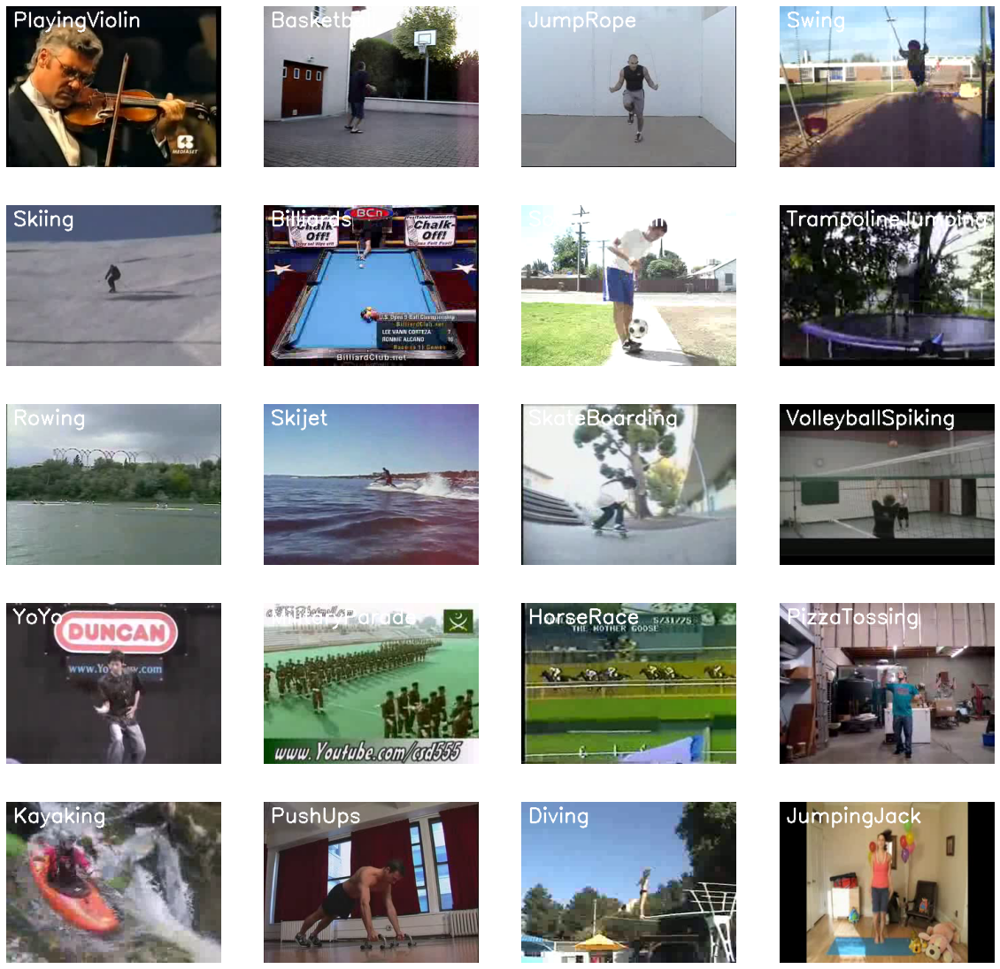

In [7]:
# Créer une figure Matplotlib et spécifier la taille de la figure.
plt.figure(figsize = (20, 20))

# Obtenir les noms de toutes les classes/catégories dans UCF50.
all_classes_names = os.listdir('UCF50')

# Générer une liste de 20 valeurs aléatoires. Les valeurs seront comprises entre 0 et 50,
# où 50 est le nombre total de classes dans l'ensemble de données.
random_range = random.sample(range(len(all_classes_names)), 20)

# Itérer à travers toutes les valeurs aléatoires générées.
for counter, random_index in enumerate(random_range, 1):

    # Selectioner un nom de classe de l'indice  random_index.
    selected_class_Name = all_classes_names[random_index]

    # Récupérer la liste de tous les fichiers vidéo présents dans la Class sélectionné .
    video_files_names_list = os.listdir(f'UCF50/{selected_class_Name}')

    # Sélectionner au hasard un fichier vidéo dans la liste extraite du répertoire de classe sélectionné au hasard.
    selected_video_file_name = random.choice(video_files_names_list)

    # Initialiser un objet VideoCapture qui permet de lireà partir du fichier selected_video_file_name.
    video_reader = cv2.VideoCapture(f'UCF50/{selected_class_Name}/{selected_video_file_name}')
    
    # Lire la première image du fichier vidéo.
    _, bgr_frame = video_reader.read()

    # Liberer l'objet VideoCapture.
    video_reader.release()

    # Convertir l'image de la forme BGR à la forme RGB . 
    rgb_frame = cv2.cvtColor(bgr_frame, cv2.COLOR_BGR2RGB)

    # Écrire le nom de la classe sur l'image vidéo.
    cv2.putText(rgb_frame, selected_class_Name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    
    # Afficher l'image
    plt.subplot(5, 4, counter);plt.imshow(rgb_frame);plt.axis('off')

## **<font style="color:rgb(134,19,348)">Step 2: Prétraitement de l'ensemble de données</font>**

Ensuite, nous effectuerons un prétraitement sur l'ensemble de données. Tout d'abord, nous allons lire les fichiers vidéo de l'ensemble de données et redimensionner les images des vidéos à une largeur et une hauteur fixes, afin de réduire les calculs et de normaliser les données  `[0-1]` en divisant les valeurs de pixel par  `255`, ce qui accélère la convergence lors de l'entrainement du réseau .

Mais d'abord, initialisons quelques constantes.

In [8]:
# Spécifier la hauteur et la largeur auxquelles chaque image vidéo sera redimensionnée dans notre ensemble de données.
IMAGE_HEIGHT , IMAGE_WIDTH = 64, 64

# Spécifier le nombre d'images d'une vidéo qui seront transmises au modèle en une seule séquence.
SEQUENCE_LENGTH = 20

# Spécifier le répertoire contenant le jeu de données UCF50.
DATASET_DIR = "UCF50"

# Spécifier la liste contenant les noms des classes utilisées pour l'entrainement. Nous choisissons n'importe quel ensemble de classes.
CLASSES_LIST = ["WalkingWithDog", "TaiChi", "Swing", "HorseRace"]

**Note:** *Les  constantes **`IMAGE_HEIGHT`**, **`IMAGE_WIDTH`** and **`SEQUENCE_LENGTH`** peuvent être augmentées pour de meilleurs résultats, bien que l'augmentation de la longueur de la séquence ne soit efficace que jusqu'à un certain point, et l'augmentation des valeurs entraînera une augmentation des coûts de calcul du processus..*

### **<font style="color:rgb(134,19,348)">Créer une fonction pour extraire, redimensionner et normaliser les images</font>**

Nous allons créer une fonction  **`frames_extraction()`** qui va créer une liste contenant les images redimensionnées et normalisées d'une vidéo dont le chemin lui est passé en argument. La fonction lira le fichier vidéo image par image, bien que toutes les images ne soient pas ajoutées à la liste car nous n'aurons besoin que d'une longueur de séquence d'images uniformément répartie.

In [9]:
def frames_extraction(video_path):
    '''
    Cette fonction extraira les images requises d'une vidéo après les avoir redimensionnées et normalisées.
    Args:
        video_path: Le chemin de la vidéo dans le disque, dont les images doivent être extraites.
    Returns:
        frames_list: Une liste contenant les images redimensionnées et normalisées de la vidéo.
    '''

    # Déclarer une liste pour stocker les images vidéo.
    frames_list = []
    
    # Lire le fichier vidéo à l'aide de l'objet VideoCapture.
    video_reader = cv2.VideoCapture(video_path)

    # Obtenir le nombre total d'images dans la vidéo.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculer l'intervalle après lequel les images seront ajoutées à la liste.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)

    # Parcourer la liste des images vidéo.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Définir la position actuelle de l'image de la vidéo.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        # Lire l'image obtenu.
        success, frame = video_reader.read() 

        # vérifier si l'image vidéo n'est pas lue avec succès, dans ce cas nous sortirons de la boucle
        if not success:
            break

        # Redimensionner l'image à une hauteur et une largeur fixes.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalisee l'image redimensionnée en la divisant par 255 afin que chaque valeur de pixel soit alors comprise entre 0 et 1
        normalized_frame = resized_frame / 255
        
        # Ajouter l'image normalisé dans la liste des images
        frames_list.append(normalized_frame)

        # Continuer à parcourir la boucle jusqu'à atteindre la valeur SEQUENCE_LENGTH
    
    # Liberer l'objet VideoCapture. 
    video_reader.release()

    # Retouner la liste des images prétraitées
    return frames_list

### **<font style="color:rgb(134,19,348)">Créer une fonction pour la création d'ensembles de données</font>**

=
Nous allons maintenant créer une fonction **`create_dataset()`** qui parcourra toutes les classes spécifiées dans la constante **`CLASSES_LIST`**  et appellera la fonction  **`frame_extraction()`** sur chaque fichier vidéo des classes sélectionnées et renverra les images (**`features`**), indice de classe( **`labels`**), et le chemin du fichier vidéo (**`video_files_paths`**)

In [10]:
def create_dataset():
    '''
    Cette fonction extraira les données des classes sélectionnées et créera l'ensemble de données requis.:
      Retourne:
        features:          Une liste contenant les images extraites des vidéos.
        labels:            Une liste contenant les index des classes associées aux vidéos.
        video_files_paths: Une liste contenant les chemins des vidéos dans le disque.
    '''

    # Declarer des listes vides pour stocker les features, les labels et les valeurs de chemin de fichier vidéo.
    features = []
    labels = []
    video_files_paths = []
    
    # Itérer à travers toutes les classes mentionnées dans la liste des classes
    for class_index, class_name in enumerate(CLASSES_LIST):
        
        # Affiche le nom de la classe dont les données sont extraites.
        print(f'Extracting Data of Class: {class_name}')
        
        # Obtenir la liste des fichiers vidéo présents dans le répertoire DATASET_DIR de la classe class_name.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))
        
        # Parcourir tous les fichiers présents dans la liste des fichiers.
        for file_name in files_list:
            
            # Obtenir le chemin complet de la vidéo courante .
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)

            # Extraire les images du fichier vidéo.
            frames = frames_extraction(video_file_path)

            # Vérifier si les images extraites sont égales à la SEQUENCE_LENGTH spécifiée ci-dessus. 
            # Ignorer donc les vidéos ayant un nombre d'images inférieur à la SEQUENCE_LENGTH.
            if len(frames) == SEQUENCE_LENGTH:

                # Ajouter les données à leurs listes respectives.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)

    # Conversion de la liste en tableaux numpy
    features = np.asarray(features)
    labels = np.array(labels)  
    
    # Returner la liste des feaetures, class index, and video file path.
    return features, labels, video_files_paths

Nous allons maintenant utiliser la fonction  **`create_dataset()`** créée ci-dessus pour extraire les données des classes sélectionnées et créer le jeu de données requis.
---


In [11]:
# Create the dataset.
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: WalkingWithDog
Extracting Data of Class: TaiChi
Extracting Data of Class: Swing
Extracting Data of Class: HorseRace


Nous allons maintenant convertir  `labels` (les index de classe) en vecteurs codés one-hot.

In [12]:
# Utilisation de la méthode to_categorical de Keras pour convertir les labels en vecteurs codés one-hot
one_hot_encoded_labels = to_categorical(labels)

## **<font style="color:rgb(134,19,348)">Step 3: Diviser les données en ensemble d'apprentissage et de test</font>**


A partir de maintenant, nous avons le nécessaire  **`features`** (un tableau NumPy contenant toutes les images extraites des vidéos) et **`one_hot_encoded_labels`** . Alors maintenant, nous allons diviser nos données pour créer des ensembles d'entraînement et de test. Nous allons également mélanger l'ensemble de données avant la division pour éviter tout biais et obtenir des divisions représentant la distribution globale des données.

In [13]:
# Diviser les données en (75 %) d'entrainement et (25 %) de test .
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels,
                                                                            test_size = 0.3, shuffle = True,
                                                                            random_state = seed_constant)

## **<font style="color:rgb(134,19,348)">Step 4: Mettre en œuvre l'approche ConvLSTM</font>**

Dans cette étape, nous mettrons en œuvre la première approche en utilisant une combinaison deConvLS™cellules. Une cellule ConvLSTM est une variante d'un réseau LSTM qui contient des opérations de convolution dans le réseau. c'est un LSTM avec convolution embarquée dans l'architecture, ce qui le rend capable d'identifier les caractéristiques spatiales des données tout en tenant compte de la relation temporelle.

<center>
<img src="https://drive.google.com/uc?export=view&id=1KHN_JFWJoJi1xQj_bRdxy2QgevGOH1qP " width= 500px>
</center>


Pour la classification vidéo, cette approche capture efficacement la relation spatiale dans les images individuelles et la relation temporelle entre les différentes images. Grâce à cette structure de convolution, le ConvLSTM est capable de prendre une entrée de 3  dimensions `(width, height, num_of_channels)` alors qu'un LSTM simple ne prend qu'une entrée unidimensionnelle, un LSTM est donc incompatible pour modéliser des données spatio-temporelles par lui-même.


### **<font style="color:rgb(134,19,348)">Step 4.1:Construire le modèle</font>**


Pour construire le modèle, nous utiliserons les couches récurrentes de Keras [**`ConvLSTM2D`**](https://keras.io/api/layers/recurrent_layers/conv_lstm2d) . La  couche **`ConvLSTM2D`**  prend également en compte le nombre de filtres et la taille du noyau requis pour appliquer les opérations convolutives. La sortie des couches est aplatie à la fin et est transmise à la  couche **`Dense`**   avec l'activation softmax qui génère la probabilité de chaque catégorie d'action.

Nous utiliserons également des couches **`MaxPooling3D`** pour réduire les dimensions des frames et éviter les calculs inutiles et des couches **`Dropout`** pour éviter l'[overfitting](https://en.wikipedia.org/wiki/Overfitting)  du modèle sur les données. L'architecture est simple et comporte un petit nombre de paramètres pouvant être entraînés. En effet, nous ne traitons qu'un petit sous-ensemble de l'ensemble de données qui ne nécessite pas de modèle à grande échelle.

In [14]:
def create_convlstm_model():
    '''
    Cette fonction construira notre modèle convlstm .
    Returne:
        model: C'est le modèle convlstm construit .
    '''

    # Nous utiliserons un modèle Sequential pour la construction du modèle
    model = Sequential()

    # Définir l'architecture du modèle.
    ########################################################################################################################
    
    model.add(ConvLSTM2D(filters = 4, kernel_size = (3, 3), activation = 'tanh',data_format = "channels_last",
                         recurrent_dropout=0.2, return_sequences=True, input_shape = (SEQUENCE_LENGTH,
                                                                                      IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
    
    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', data_format='channels_last'))
    model.add(TimeDistributed(Dropout(0.2)))
    
    model.add(ConvLSTM2D(filters = 8, kernel_size = (3, 3), activation = 'tanh', data_format = "channels_last",
                         recurrent_dropout=0.2, return_sequences=True))

    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', data_format='channels_last'))
    model.add(TimeDistributed(Dropout(0.2)))
    
    model.add(ConvLSTM2D(filters = 14, kernel_size = (3, 3), activation = 'tanh', data_format = "channels_last",
                         recurrent_dropout=0.2, return_sequences=True))
    
    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', data_format='channels_last'))
    model.add(TimeDistributed(Dropout(0.2)))
    
    model.add(ConvLSTM2D(filters = 16, kernel_size = (3, 3), activation = 'tanh', data_format = "channels_last",
                         recurrent_dropout=0.2, return_sequences=True))
    
    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', data_format='channels_last'))
    
    model.add(Flatten()) 
    
    model.add(Dense(len(CLASSES_LIST), activation = "softmax"))
    
    ########################################################################################################################
     
    # Afficher la resumé de notre model.
    model.summary()
    
    # Retourner le model convlstm construit
    return model

Nous allons maintenant utiliser la fonction  **`create_convlstm_model()`** créée ci-dessus pour construire le  `convlstm` modèle requis.

In [15]:
# Construire le modèle convlstm requis.
convlstm_model = create_convlstm_model()

# Afficher un message de succes 
print("Modèle créé avec succès !")

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv_lstm2d (ConvLSTM2D)    (None, 20, 62, 62, 4)     1024      
                                                                 
 max_pooling3d (MaxPooling3D  (None, 20, 31, 31, 4)    0         
 )                                                               
                                                                 
 time_distributed (TimeDistr  (None, 20, 31, 31, 4)    0         
 ibuted)                                                         
                                                                 
 conv_lstm2d_1 (ConvLSTM2D)  (None, 20, 29, 29, 8)     3488      
                                                                 
 max_pooling3d_1 (MaxPooling  (None, 20, 15, 15, 8)    0         
 3D)                                                             
                                                        

#### **<font style="color:rgb(134,19,348)">Vérifier la structure du modèle:</font>**
Nous allons maintenant utiliser la fonction **`plot_model()`**  pour vérifier la structure du modèle construit, cela est utile lors de la construction d'un réseau complexe et en veillant à ce que le réseau soit créé correctement.


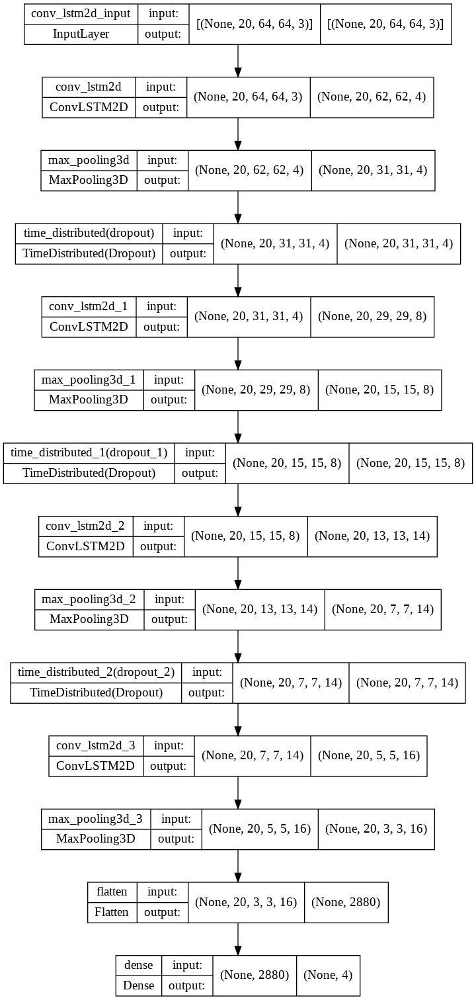

In [16]:
# Tracer la structure du modèle construit.
plot_model(convlstm_model, to_file = 'convlstm_model_structure_plot.png', show_shapes = True, show_layer_names = True)

### **<font style="color:rgb(134,19,348)">Step 4.2: Compiler et entrainer le modèle</font>**

Ensuite, nous ajouterons un rappel d'arrêt précoce pour éviter l' [overfitting](https://en.wikipedia.org/wiki/Overfitting)  et commencerons l'entraînement après la compilation du modèle.

In [17]:
# Creer une Instance de Early Stopping Callback
early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 10, mode = 'min', restore_best_weights = True)

# Compiler le modèle et spécifiez les valeurs de la fonction loss, optimizer et metrics values pour le modèle
convlstm_model.compile(loss = 'categorical_crossentropy', optimizer = 'Adam', metrics = ["accuracy"])

# Commencer l'entrainement du modele.
convlstm_model_training_history = convlstm_model.fit(x = features_train, y = labels_train, epochs = 50, batch_size = 4,
                                                     shuffle = True, validation_split = 0.2, 
                                                     callbacks = [early_stopping_callback])

Epoch 1/50
68/68 [==============================] - 140s 2s/step - loss: 1.4016 - accuracy: 0.2132 - val_loss: 1.3776 - val_accuracy: 0.3676
Epoch 2/50
68/68 [==============================] - 131s 2s/step - loss: 1.3492 - accuracy: 0.3566 - val_loss: 1.3823 - val_accuracy: 0.3382
Epoch 3/50
68/68 [==============================] - 130s 2s/step - loss: 1.1715 - accuracy: 0.4596 - val_loss: 1.3199 - val_accuracy: 0.3824
Epoch 4/50
68/68 [==============================] - 130s 2s/step - loss: 1.0236 - accuracy: 0.5956 - val_loss: 1.1245 - val_accuracy: 0.3824
Epoch 5/50
68/68 [==============================] - 131s 2s/step - loss: 0.8107 - accuracy: 0.6912 - val_loss: 0.9898 - val_accuracy: 0.5735
Epoch 6/50
68/68 [==============================] - 130s 2s/step - loss: 0.6972 - accuracy: 0.7353 - val_loss: 0.9367 - val_accuracy: 0.6029
Epoch 7/50
68/68 [==============================] - 130s 2s/step - loss: 0.5212 - accuracy: 0.7868 - val_loss: 0.8825 - val_accuracy: 0.6765
Epoch 8/50
68

#### **<font style="color:rgb(134,19,348)">Évaluer le modèle entrainé</font>**

Après l'entrainement, nous évaluerons le modèle sur l'ensemble de test.

In [18]:
# Evaluer le model entrainé
model_evaluation_history = convlstm_model.evaluate(features_test, labels_test)

5/5 [==============================] - 18s 3s/step - loss: 0.6826 - accuracy: 0.7347


#### **<font style="color:rgb(134,19,348)">Enregistrer le modele</font>**

Nous allons maintenant enregistrer le modèle pour éviter de l'entraîner à partir de zéro chaque fois que nous en aurons besoin.

In [19]:
# Obtenir le loss et accuracy a partir de model_evaluation_history.
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history

# Définir le format de date .
# Obtenir la date et l'heure actuelles dans un objet DateTime.
# Convertissez l'objet DateTime en chaîne selon le style mentionné dans la chaîne date_time_format.
date_time_format = '%Y_%m_%d__%H_%M_%S'
current_date_time_dt = dt.datetime.now()
current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)

# Définir un nom utile pour notre modèle afin de faciliter la navigation dans plusieurs modèles enregistrés.
model_file_name = f'convlstm_model___Date_Time_{current_date_time_string}___Loss_{model_evaluation_loss}___Accuracy_{model_evaluation_accuracy}.h5'

# Enregistrer le modele
convlstm_model.save(model_file_name)

### **<font style="color:rgb(134,19,348)">Step 4.3:Tracer les courbes de  Loss & Accuracy Curves</font>**

Nous allons maintenant créer une fonction  **`plot_metric()`**pour visualiser les métriques d'entrainement et de validation. Nous avons déjà des mesures distinctes de nos étapes de formation et de validation, il ne nous reste plus qu'à les visualiser.

In [20]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):
    '''
    Cette fonction tracera les métriques qui lui sont transmises dans un graphique.
    Args:
        model_training_history: Un objet d'historique contenant un enregistrement des valeurs 
                                de loss d'entrainement et de validation et des valeurs de métriques à des époques successives
        metric_name_1:          Le nom de la première metrique qui doit être tracée dans le graphique.
        metric_name_2:          Le nom de la deuxiemme mesure qui doit être tracée dans le graphique.
        plot_name:              Le titre du graphe
    '''
    
    # Obtenir des valeurs de métriques en utilisant des noms de métriques comme identifiants.
    metric_value_1 = model_training_history.history[metric_name_1]
    metric_value_2 = model_training_history.history[metric_name_2]
    
    # Construct a range object which will be used as x-axis (horizontal plane) of the graph.
    epochs = range(len(metric_value_1))

    # Tracer le graphe
    plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
    plt.plot(epochs, metric_value_2, 'red', label = metric_name_2)

    # Ajouter un titre au plot.
    plt.title(str(plot_name))

    # Ajouter une legende au plot.
    plt.legend()


Nous allons maintenant utiliser la fonction  **`plot_metric()`** créée ci-dessus pour visualiser les métriques.

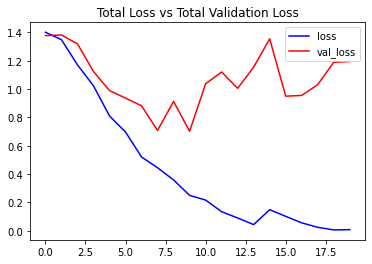

In [21]:
# Visualiser les metriques de training loss et validation loss .
plot_metric(convlstm_model_training_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

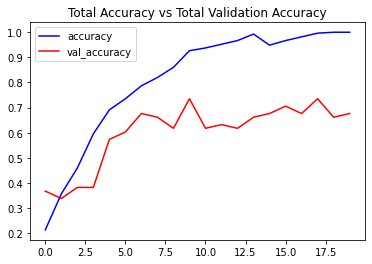

In [22]:
# Visualiser les metriques de training accuaracy et validation accuaracy .
plot_metric(convlstm_model_training_history, 'accuracy', 'val_accuracy', 'Total Accuracy vs Total Validation Accuracy') 

## **<font style="color:rgb(134,19,348)">Step 5: Mettre en œuvre l'approche LRCN</font>**

Dans cette étape, nous mettrons en œuvre l'approche LRCN en combinant les couches Convolution et LSTM dans un seul modèle. Une autre approche similaire peut consister à utiliser un modèle CNN et un modèle LSTM formés séparément. Le modèle CNN peut être utilisé pour extraire des caractéristiques spatiales des images de la vidéo, et à cette fin, un modèle pré-formé peut être utilisé, qui peut être affiné pour le problème. Et le modèle LSTM peut alors utiliser les caractéristiques extraites par CNN, pour prédire l'action effectuée dans la vidéo.

Mais ici, nous mettrons en œuvre une autre approche connue sous le nom de Long-term Recurrent Convolutional Network (LRCN), qui combine les couches CNN et LSTM dans un seul modèle. Les couches convolutionnelles sont utilisées pour l'extraction de caractéristiques spatiales à partir des images, et les caractéristiques spatiales extraites sont transmises à la ou aux couches LSTM à chaque pas de temps pour la modélisation de séquence temporelle. De cette façon, le réseau apprend les caractéristiques spatio-temporelles directement dans une formation de bout en bout, résultant en un modèle robuste.

<center>
<img src='https://drive.google.com/uc?export=download&id=1I-q5yLsIoNh2chfzT7JYvra17FsXvdme'>
</center>





Nous utiliserons également le  [**`TimeDistributed`**](https://keras.io/api/layers/recurrent_layers/time_distributed/) wrapper layer, qui permet d'appliquer le même layer à chaque image de la vidéo indépendamment. Ainsi, il crée un layer capable de prendre une forme d'entrée  `(no_of_frames, width, height, num_of_channels)` si à l'origine la forme d'entrée du layer était `(width, height, num_of_channels)`  ce qui est très bénéfique car il permet d'entrer la vidéo entière dans le modèle en un seul coup. 
<center>
<img src='https://drive.google.com/uc?export=download&id=1CbauSm5XTY7ypHYBHH7rDSnJ5LO9CUWX' width=400>
</center>

### **<font style="color:rgb(134,19,348)">Step 5.1: Construire le modèle</font>**


Pour implémenter notre architecture LRCN, nous utiliserons des couches **`Conv2D`**   qui seront suivis de couches **`MaxPooling2D`** et  L'entité **`Dropout`**  extraite des couches **`Conv2D`**  sera ensuite aplatie à l'aide de la couche  **`Flatten`**  et sera transmise à la couche  **`LSTM`** . La couche  **`Dense`**   avec activation softmax utilisera alors la sortie de la couche  **`LSTM`**  pour prédire l'action en cours.

In [23]:
def create_LRCN_model():
    '''
    Cette fonction construira le modèle LRCN requis.
    Returns:
        model: C'est le modèle LRCN construit requis.
    '''

    # Nous utiliserons un modèle Sequential pour la construction du modèle
    model = Sequential()
    
    # Definir l'architecture du modele
    ########################################################################################################################
    
    model.add(TimeDistributed(Conv2D(16, (3, 3), padding='same',activation = 'relu'),
                              input_shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
    
    model.add(TimeDistributed(MaxPooling2D((4, 4)))) 
    model.add(TimeDistributed(Dropout(0.25)))
    
    model.add(TimeDistributed(Conv2D(32, (3, 3), padding='same',activation = 'relu')))
    model.add(TimeDistributed(MaxPooling2D((4, 4))))
    model.add(TimeDistributed(Dropout(0.25)))
    
    model.add(TimeDistributed(Conv2D(64, (3, 3), padding='same',activation = 'relu')))
    model.add(TimeDistributed(MaxPooling2D((2, 2))))
    model.add(TimeDistributed(Dropout(0.25)))
    
    model.add(TimeDistributed(Conv2D(64, (3, 3), padding='same',activation = 'relu')))
    model.add(TimeDistributed(MaxPooling2D((2, 2))))
                                      
    model.add(TimeDistributed(Flatten()))
                                      
    model.add(LSTM(32))
                                      
    model.add(Dense(len(CLASSES_LIST), activation = 'softmax'))

    ########################################################################################################################

    # Afficher la resumé de notre model.
    model.summary()
    
    # Retourner le modele LRCN construit
    return model


Nous allons maintenant utiliser la fonction **`create_LRCN_model()`** créé ci-dessus pour construire le modèle  `LRCN`  requis.

In [24]:
# Construire le modele LRCN requis
LRCN_model = create_LRCN_model()

# Afficher un message de succes
print("Modèle créé avec succès !")

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_3 (TimeDis  (None, 20, 64, 64, 16)   448       
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, 20, 16, 16, 16)   0         
 tributed)                                                       
                                                                 
 time_distributed_5 (TimeDis  (None, 20, 16, 16, 16)   0         
 tributed)                                                       
                                                                 
 time_distributed_6 (TimeDis  (None, 20, 16, 16, 32)   4640      
 tributed)                                                       
                                                                 
 time_distributed_7 (TimeDis  (None, 20, 4, 4, 32)    

#### **<font style="color:rgb(134,19,348)">Vérifier la structure du modèle :</font>**

Nous allons maintenant utiliser la  fonction **`plot_model()`**  pour vérifier la structure du modèle `LRCN` construit. Comme nous l'avions vérifié pour le modèle précédent. 

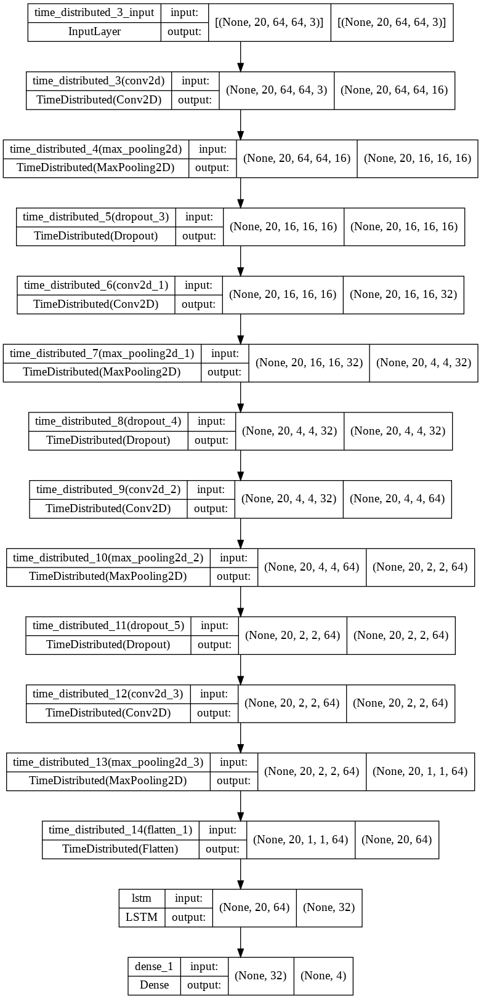

In [25]:
# Tracer la structure du modèle LRCN construit.
plot_model(LRCN_model, to_file = 'LRCN_model_structure_plot.png', show_shapes = True, show_layer_names = True)

### **<font style="color:rgb(134,19,348)">Step 5.2: Compiler et entrainer le modèle</font>**

Après avoir vérifier la structure, nous allons compiler et commencer à entrainer le modèle.

In [26]:
# Creer une Instance de Early Stopping Callback
early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 15, mode = 'min', restore_best_weights = True)
 
# Compiler le modèle et spécifiez les valeurs de la fonction loss, optimizer et metrics values pour le modèle
LRCN_model.compile(loss = 'categorical_crossentropy', optimizer = 'Adam', metrics = ["accuracy"])

# Commencer l'entrainement du modele
LRCN_model_training_history = LRCN_model.fit(x = features_train, y = labels_train, epochs = 70, batch_size = 4 ,
                                             shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback])

Epoch 1/70
68/68 [==============================] - 15s 190ms/step - loss: 1.4017 - accuracy: 0.2279 - val_loss: 1.3755 - val_accuracy: 0.2353
Epoch 2/70
68/68 [==============================] - 12s 180ms/step - loss: 1.3600 - accuracy: 0.3235 - val_loss: 1.3461 - val_accuracy: 0.3088
Epoch 3/70
68/68 [==============================] - 12s 181ms/step - loss: 1.1847 - accuracy: 0.4596 - val_loss: 1.2621 - val_accuracy: 0.4559
Epoch 4/70
68/68 [==============================] - 12s 179ms/step - loss: 1.0408 - accuracy: 0.5735 - val_loss: 1.3328 - val_accuracy: 0.4265
Epoch 5/70
68/68 [==============================] - 12s 180ms/step - loss: 0.8995 - accuracy: 0.6397 - val_loss: 1.1419 - val_accuracy: 0.5147
Epoch 6/70
68/68 [==============================] - 12s 181ms/step - loss: 0.7707 - accuracy: 0.6875 - val_loss: 1.0158 - val_accuracy: 0.5735
Epoch 7/70
68/68 [==============================] - 12s 179ms/step - loss: 0.7711 - accuracy: 0.6875 - val_loss: 0.8619 - val_accuracy: 0.6912

#### **<font style="color:rgb(134,19,348)">Évaluation du modèle entrainé</font>**

Comme pour le précédent, nous allons évaluer le modèle `LRCN`  sur le jeu de test.

In [27]:
# Evaluer le modele entrainé
model_evaluation_history = LRCN_model.evaluate(features_test, labels_test)

5/5 [==============================] - 3s 401ms/step - loss: 0.5196 - accuracy: 0.8503


#### **<font style="color:rgb(134,19,348)">Enregistrer le modèle</font>**

Après cela, nous enregistrerons le modèle pour des utilisations futures en utilisant la même technique que nous avions utilisée pour le modèle précédent.

In [28]:
# Obtenir le loss et accuracy a partir de model_evaluation_history.
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history

# Définir le format de date .
# Obtenir la date et l'heure actuelles dans un objet DateTime.
# Convertissez l'objet DateTime en chaîne selon le style mentionné dans la chaîne date_time_format.
date_time_format = '%Y_%m_%d__%H_%M_%S'
current_date_time_dt = dt.datetime.now()
current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)
    
# Définir un nom utile pour notre modèle afin de faciliter la navigation dans plusieurs modèles enregistrés.
model_file_name = f'LRCN_model___Date_Time_{current_date_time_string}___Loss_{model_evaluation_loss}___Accuracy_{model_evaluation_accuracy}.h5'

# Enregistrer le Modele.
LRCN_model.save(model_file_name)

### **<font style="color:rgb(134,19,348)">Step 5.3: Tracer les courbes de Loss & Accuracy Curves</font>**


Nous allons maintenant utiliser la fonction **`plot_metric()`** que nous avions créé ci-dessus pour visualiser les métriques d'entraînement et de validation de ce modèle.


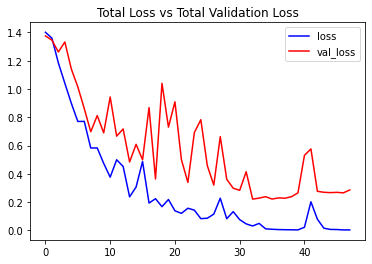

In [29]:
# Visualiser les metriques de training loss et validation loss .
plot_metric(LRCN_model_training_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

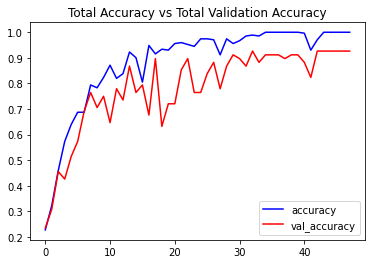

In [30]:
# Visualiser les metriques de training accuaracy et validation accuaracy .
plot_metric(LRCN_model_training_history, 'accuracy', 'val_accuracy', 'Total Accuracy vs Total Validation Accuracy')

## **<font style="color:rgb(134,19,348)">Step 6: Tester le modèle le plus performant sur les vidéos YouTube</font>**


D'après les résultats, il semble que le modèle LRCN ait obtenu de bons résultats pour un petit nombre de classes. donc dans cette étape, nous allons mettre le modèle `LRCN` à tester sur quelques vidéos youtube.

### **<font style="color:rgb(134,19,348)">Créer une fonction pour télécharger des vidéos YouTube ::</font>**

Nous allons créer une fonction  **`download_youtube_videos()`**  pour télécharger d'abord les vidéos YouTube à l'aide  de la bibliothèque **`pafy`**. La bibliothèque n'a besoin que d'une URL vers une vidéo pour la télécharger avec ses métadonnées associées comme le titre de la vidéo.

In [31]:
def download_youtube_videos(youtube_video_url, output_directory):
     '''
      Cette fonction télécharge la vidéo youtube dont l'URL lui est passée en argument.
    Args:
        youtube_video_url: URL de la vidéo qui doit être téléchargée.
        output_directory:  Le chemin du répertoire dans lequel la vidéo doit être stockée après le téléchargement.
    Returns:
        title: Le titre de la vidéo youtube téléchargée.
    '''
 
     # Créer un objet vidéo qui contient des informations utiles sur la vidéo.
     video = pafy.new(youtube_video_url)
 
     # Récupérer le titre de la vidéo.
     title = video.title
 
     # Obtenir le meilleur objet de qualité disponible pour la vidéo.
     video_best = video.getbest()
 
     # Construire le chemin du fichier de sortie.
     output_file_path = f'{output_directory}/{title}.mp4'
 
     # Télécharger la vidéo youtube avec la meilleure qualité disponible et stocker-la dans le chemin construit.
     video_best.download(filepath = output_file_path, quiet = True)
 
     # Renvoie le titre de la vidéo.
     return title

### **<font style="color:rgb(134,19,348)">Téléchargez une vidéo de test :</font>**

Nous allons maintenant utiliser la fonction  **`download_youtube_videos()`** créée ci-dessus pour télécharger une vidéo youtube sur laquelle le  modèle `LRCN` sera testé.

In [32]:
# Créer le répertoire de sortie s'il n'existe pas
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)

# Télécharger une vidéo YouTube.
video_title = download_youtube_videos('https://www.youtube.com/watch?v=XqqpZS0c1K0', test_videos_directory)

# Obtenir le chemin des vidéos YouTube que nous venons de télécharger.
input_video_file_path = f'{test_videos_directory}/{video_title}.mp4'

### **<font style="color:rgb(134,19,348)">Créer une fonction pour effectuer la reconnaissance d'action sur les vidéos</font>**

Ensuite, nous allons créer une fonction **`predict_on_video()`** qui lira simplement une vidéo image par image à partir du chemin passé en argument et effectuera la reconnaissance d'action sur la vidéo et enregistrera les résultats.

In [33]:
def predict_on_video(video_file_path, output_file_path, SEQUENCE_LENGTH):
    '''
      Cette fonction effectuera une reconnaissance d'action sur une vidéo en utilisant le modèle LRCN.
    Args:
    video_file_path: Le chemin de la vidéo stockée sur le disque sur lequel la reconnaissance d'action doit être effectuée.
    output_file_path: Le chemin où la vidéo de sortie avec l'action prévue en cours d'exécution superposée sera stockée.
    SEQUENCE_LENGTH: Nombre fixe d'images d'une vidéo pouvant être transmises au modèle en une seule séquence.
    '''

    # Initialiser l'objet VideoCapture pour lire à partir du fichier vidéo.
    video_reader = cv2.VideoCapture(video_file_path)

    # Obtenir la largeur et la hauteur de la vidéo.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Initialiser l'objet VideoWriter pour stocker la vidéo de sortie sur le disque.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('M', 'P', '4', 'V'), 
                                   video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))

    # Déclarer une file d'attente pour stocker les images vidéo.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)

    # Initialiser une variable pour stocker l'action prédite en cours d'exécution dans la vidéo.
    predicted_class_name = ''

    # Itérer jusqu'à ce que la vidéo soit accessible avec succès.
    while video_reader.isOpened():

        # Lire la frame
        ok, frame = video_reader.read() 
        
        # Vérifier si la frame n'est pas lue correctement sinon sortir de la boucle.
        if not ok:
            break

        # Redimensionner la frame à des dimensions fixes.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normaliser la frame redimensionnée en la divisant par 255 afin que chaque valeur de pixel soit alors comprise entre 0 et 1.
        normalized_frame = resized_frame / 255

        # Ajout de la frame prétraitée dans la liste des frames.
        frames_queue.append(normalized_frame)

        # Vérifier si le nombre de frames dans la file d'attente est égal à la longueur de séquence fixe.
        if len(frames_queue) == SEQUENCE_LENGTH:

            # Passer les frames normalisées au modèle et obtenir les probabilités prédites.
            predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_queue, axis = 0))[0]

            # Obtenir l'indice de la classe avec la probabilité la plus élevée.
            predicted_label = np.argmax(predicted_labels_probabilities)

            # Obtenir le nom de la classe à l'aide de l'index récupéré.
            predicted_class_name = CLASSES_LIST[predicted_label]

        #  Écrire le nom de la classe prédite en haut de la frame
        cv2.putText(frame, predicted_class_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        # Écrire l'image sur le disque à l'aide de l'objet VideoWriter.
        video_writer.write(frame)
        
    # Libérer les objets VideoCapture et VideoWriter.
    video_reader.release()
    video_writer.release()

### **<font style="color:rgb(134,19,348)">Effectuer une reconnaissance d'action sur la vidéo de test</font>**



Nous allons maintenant utiliser la fonction   **`predict_on_video()`** créée ci-dessus pour effectuer une reconnaissance d'action sur la vidéo de test que nous avons téléchargé à l'aide de la fonction **`download_youtube_videos()`** et afficher la vidéo de sortie avec l'action prédite superposée.

In [34]:
# Construire le chemin vidéo de sortie.
output_video_file_path = f'{test_videos_directory}/{video_title}-Output-SeqLen{SEQUENCE_LENGTH}.mp4'

# Effectuer une reconnaissance d'action sur la vidéo de test.
predict_on_video(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Afficher la vidéo de sortie
VideoFileClip(output_video_file_path, audio=False, target_resolution=(300,None)).ipython_display()

100%|█████████▉| 1650/1651 [00:15<00:00, 104.50it/s]
